jupyter note book で提出すること。（注意：google colabから作った場合、共有設定を忘れないように）

１．RK4次以上で解いた。単剛体振り子のコードがあること。

２．3次元モデルを読み込んで、重心、慣性モーメントを求めるコードがあること。

３．２．を用いて１を改良したコードがあること。

４．上記を参考に2重剛体振り子のコードがあること。

５．それぞれのコード間にコードの概要や物理現象についての概要を説明したドキュメントがあること。

６．アニメーション・パラパラ漫画等でシミュレーションの結果を可視化すること

# 2次元単質点振り子のシミュレーション

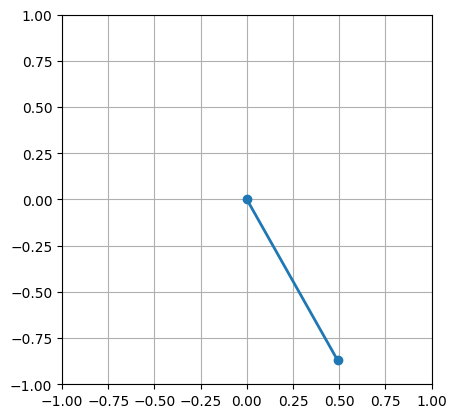

In [3]:
from numpy import sin, cos
from scipy.integrate import solve_ivp
from matplotlib.animation import FuncAnimation
import matplotlib.pyplot as plt
import numpy as np

G = 9.8                                 # 重力加速度 [m/s^2]
L = 1.0                                 # 振り子の長さ [m]

# 運動方程式
def derivs(t, state):
    dydt = np.zeros_like(state)
    dydt[0] = state[1]
    dydt[1] = -(3 * G/ 2 * L)*sin(state[0])
    return dydt

t_span = [0, 5]                         # 観測時間 [s]
dt = 0.05                               # 間隔 [s]
t = np.arange(t_span[0], t_span[1], dt)
th1 = 30.0                              # 初期角度 [deg]
w1 = 0.0                                # 初期角速度 [deg/s]
state = np.radians([th1, w1])           # 初期状態

sol = solve_ivp(derivs, t_span, state, t_eval=t,method='RK45')
theta = sol.y[0, :]

x = L * sin(theta)       # x = Lsin(theta)
y = -L * cos(theta)      # y = -Lcos(theta)

fig, ax = plt.subplots()

line, = ax.plot([], [], 'o-', linewidth=2) # このlineに次々と座標を代入して描画

ax.set_xlim(-L, L)
ax.set_ylim(-L, L)
ax.set_aspect('equal')
ax.grid()

def animate(i):
    thisx = [0, x[i]]
    thisy = [0, y[i]]

    line.set_data(thisx, thisy)
    return line,

ani = FuncAnimation(fig, animate, frames=np.arange(0, len(t)), interval=dt * 1000, blit=True)


# 画像を表示
# plt.show()

# Colab上でアニメーションを表示する(１分ほど時間がかかります)
from IPython.display import HTML
HTML(ani.to_jshtml())


# stlファイルの読み込み、表示

### stlファイルをNumpyで読み込むためのライブラリが必要！

In [4]:
pip install numpy-stl

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 25.1.1
[notice] To update, run: C:\Users\inyt1\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


## stlファイルの作成

### 直方体(rectangle.stl)

In [5]:
import numpy as np
from stl import mesh

vertices = np.array([
    [-1, -1, -10],  # 0
    [1, -1, -10],   # 1
    [1, 1, -10],    # 2
    [-1, 1, -10],   # 3
    [-1, -1, 0],   # 4
    [1, -1, 0],    # 5
    [1, 1, 0],     # 6
    [-1, 1, 0]     # 7
])

# 面を定義
faces = np.array([
    [0, 1, 5],
    [0, 5, 4],
    [1, 2, 6],
    [1, 6, 5],
    [2, 3, 7],
    [2, 7, 6],
    [3, 0, 4],
    [3, 4, 7],
    [0, 3, 2],
    [0, 2, 1],
    [4, 5, 6],
    [4, 6, 7]
])


# Create the mesh
cube = mesh.Mesh(np.zeros(faces.shape[0], dtype=mesh.Mesh.dtype))
for i, f in enumerate(faces):
    for j in range(3):
        cube.vectors[i][j] = vertices[f[j],:]

# Write the mesh to file "cube.stl"
cube.save('rectangle.stl')



## stlファイルのプレビュー

### 読み込むファイルはコードのmain関数該当部で指定してください！

header: b'numpy-stl (3.2.0) 2025-05-18 22:45:35.812537 rectangle.stl                      '
三角形の数: 12


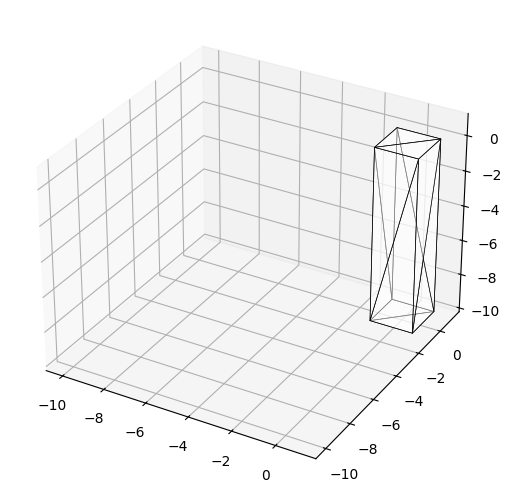

In [6]:
import numpy as np
from stl import mesh
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d
import struct

def load_stl(filename):
    with open(filename, "rb") as f:
        header = f.read(80)                             # header
        n_triangles = struct.unpack("I", f.read(4))[0]  # 三角形の数．unpackはtupleを返すので0番目を取り出す．
        print(f"header: {header}")
        print(f"三角形の数: {n_triangles}")

        vertices = []
        for i in range(n_triangles):                    # 各三角形ごとに
            norm = struct.unpack("3f", f.read(4*3))     # 法線ベクトル
            vert1 = struct.unpack("3f", f.read(4*3))    # 頂点1
            vert2 = struct.unpack("3f", f.read(4*3))    # 頂点2
            vert3 = struct.unpack("3f", f.read(4*3))    # 頂点3
            _ = f.read(2)                               # 未使用データ

            vert = np.asarray([vert1, vert2, vert3])    # 3つの頂点をまとめる
            vertices.append(vert)
        vertices = np.stack(vertices)

        # verticesは (三角形の数, 頂点の数 3, 頂点の座標 3) の形
        return vertices, n_triangles


def plot_stl(vectors):
    figure = plt.figure()
    axes = mplot3d.Axes3D(figure)
    # 下の行を追加しないと描画されない　注意！
    figure.add_axes(axes)

    collection = mplot3d.art3d.Poly3DCollection(vectors)
    collection.set_linewidth(0.5)
    collection.set_facecolor("w")
    collection.set_edgecolor("black")
    collection.set_alpha(0.5)

    axes.add_collection3d(collection)

    scale = vectors.flatten()
    axes.auto_scale_xyz(scale, scale, scale)


#　読み込むファイルはここで指定してください！ pyramid.stl or cube.stl or rectangle.stl
stl_filename = "rectangle.stl"
vectors, n_triangles = load_stl(stl_filename)
plot_stl(vectors)

# 重心と慣性モーメントを求めて3次元単剛体振り子

### mesh_data.get_mass_properties()メソッドでは、xyz軸上の慣性モーメントしか求められないため、デフォルトでy軸中心に回ります。



header: b'numpy-stl (3.2.0) 2025-05-18 22:45:35.812537 rectangle.stl                      '
三角形の数: 12
固定点:  [0 0 0]
重心: [ 0.     0.    -0.005]
y軸中心の慣性モーメント: 0.0003466666666666665
回転軸から重心までの距離:  0.005
慣性モーメント I = 0.0003466666666666665 [kg·m²]
重心距離 a = 0.005 [m]
mga/I = 141.34615384615392 [rad/s²]


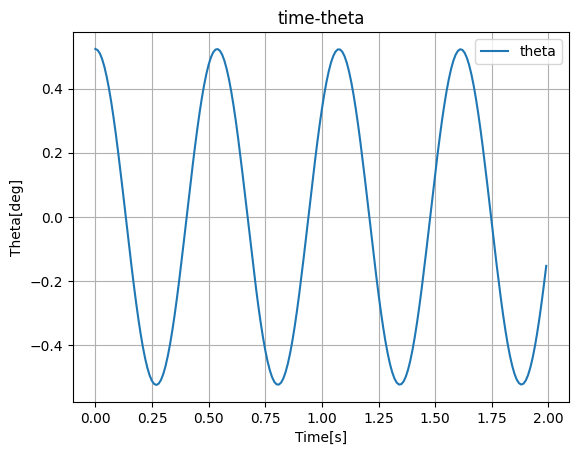

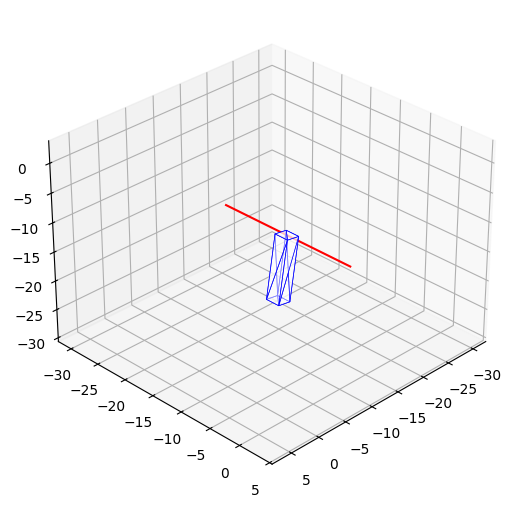

In [7]:
from stl import mesh
from numpy import sin, cos
from scipy.integrate import solve_ivp
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
import struct
from mpl_toolkits import mplot3d

def load_stl(filename):
    with open(filename, "rb") as f:
        header = f.read(80)                             # header
        n_triangles = struct.unpack("I", f.read(4))[0]  # 三角形の数．unpackはtupleを返すので0番目を取り出す．
        print(f"header: {header}")
        print(f"三角形の数: {n_triangles}")

        vertices = []
        for i in range(n_triangles):                    # 各三角形ごとに
            norm = struct.unpack("3f", f.read(4*3))     # 法線ベクトル
            vert1 = struct.unpack("3f", f.read(4*3))    # 頂点1
            vert2 = struct.unpack("3f", f.read(4*3))    # 頂点2
            vert3 = struct.unpack("3f", f.read(4*3))    # 頂点3
            _ = f.read(2)                               # 未使用データ

            vert = np.asarray([vert1, vert2, vert3])    # 3つの頂点をまとめる
            vertices.append(vert)
        vertices = np.stack(vertices)

        # verticesは (三角形の数, 頂点の数 3, 頂点の座標 3) の形
        return vertices, n_triangles


def plot_stl(vectors):
    figure = plt.figure()
    axes = mplot3d.Axes3D(figure)
    # 下の行を追加しないと描画されない　注意！
    figure.add_axes(axes)

    collection = mplot3d.art3d.Poly3DCollection(vectors)
    collection.set_linewidth(0.5)
    collection.set_facecolor("w")
    collection.set_edgecolor("black")
    collection.set_alpha(0.5)

    axes.add_collection3d(collection)

    scale = vectors.flatten()
    axes.auto_scale_xyz(scale, scale, scale)

def compute_centroid_inertia(stl_file_path, n_triangles,rotation_axis):
    # STLファイルの読み込み
    mesh_data = mesh.Mesh.from_file(stl_file_path)
    volume, cog, inertia = mesh_data.get_mass_properties()
    # y軸周りの慣性モーメントは[1][1]に入ってるらしい
    return cog, inertia[1][1]


def rotate_vectors(vectors, theta):
    # Rotation matrix around y-axis
  R_y = np.array([[np.cos(theta), 0, np.sin(theta)],
                  [0, 1, 0],
                  [-np.sin(theta), 0, np.cos(theta)]])

  # Rotate each vector
  rotated_vectors = np.array([np.dot(R_y, vector.T).T for vector in vectors])

  return rotated_vectors

# STLファイルの読み込み
stl_filename = "rectangle.stl"
vectors, n_triangles = load_stl(stl_filename)

# 回転軸を指定して、回転軸回りの慣性モーメントを求められる
rotation_axis = np.array([0, 0, 0]) # 固定単を指定
centroid , inertia = compute_centroid_inertia(stl_filename, n_triangles, rotation_axis)

# 単位系修正
scale_factor = 0.001  # mm → m
inertia *= (scale_factor**2)  # 慣性モーメント修正
centroid *= scale_factor      # 重心位置修正

print("固定点: ", rotation_axis)
print(f"重心: {centroid}")
print(f"y軸中心の慣性モーメント: {inertia}")

G = 9.8                                                    # 重力加速度 [m/s^2]
a = np.linalg.norm(rotation_axis - centroid)               # 回転軸から重心までの長さ [m]
print("回転軸から重心までの距離: ", a)
m = 1.0                                                    # 振り子の重さ [kg]

# デバッグ表示
print(f"慣性モーメント I = {inertia} [kg·m²]")
print(f"重心距離 a = {a} [m]")
print(f"mga/I = {m * G * a / inertia} [rad/s²]") 

# # 運動方程式
def derivs(t, state):
   dydt = np.zeros_like(state)
   dydt[0] = state[1]
   dydt[1] = -(m * G * a * sin(state[0]) / inertia ) # 単振り子と剛体振り子の違いはここだけ
   return dydt

t_span = [0, 2]                         # 観測時間 [s]
dt = 0.01                               # 間隔 [s]
t = np.arange(t_span[0], t_span[1], dt)
th1 = 30.0                              # 初期角度 [deg]
w1 = 0.0                                # 初期角速度 [deg/s]
state = np.radians([th1, w1])           # 初期状態

sol = solve_ivp(derivs, t_span, state, t_eval=t,method='RK45')
theta = sol.y[0, :]

# # グラフの描画
plt.plot(t, theta, label='theta')
plt.title('time-theta')
plt.xlabel('Time[s]')
plt.ylabel('Theta[deg]')
plt.legend()
plt.grid(True)
plt.show()


# fig の設定
figure = plt.figure()
axes = mplot3d.Axes3D(figure)
# 下の行を追加しないと描画されない　注意！
figure.add_axes(axes)

# カメラの位置
axes.view_init(elev=30, azim=45)
axes.dist = 8

collection = mplot3d.art3d.Poly3DCollection(vectors)
collection.set_linewidth(0.5)
collection.set_facecolor("w")
collection.set_edgecolor("blue")
collection.set_alpha(0.5)


axes.add_collection3d(collection)
# y軸を赤線で表示
axes.plot3D([0, 0], [-10, 10], [0, 0], color='red')
scaling_factor = 3
scale = vectors.flatten() * scaling_factor
axes.auto_scale_xyz(scale, scale, scale)


def animate(i):
    # 前のプロットを削除
    for collection in axes.collections:
        collection.remove()

    # rotation_axis を原点に持っていく
    for vector in vectors:
      vector -= rotation_axis

    # 回転させて、新しい図形を得る
    rotated_vectors = rotate_vectors(vectors, theta[i])
    # print(rotated_vectors)

    # rotation_axisに戻す
    for vector in vectors:
      vector += rotation_axis

    # Poly3DCollection を更新
    collection = mplot3d.art3d.Poly3DCollection(rotated_vectors)
    collection.set_linewidth(0.5)
    collection.set_facecolor("w")
    collection.set_edgecolor("blue")
    collection.set_alpha(0.5)

    axes.add_collection3d(collection)
    return [collection]

skip_frames = 10
ani = FuncAnimation(figure, animate, 
                    frames=len(t),
                    interval = 20,
                     blit=True,
                     repeat=True
                     )

# Colab上でアニメーションを表示する(１分ほど時間がかかります)
from IPython.display import HTML
HTML(ani.to_jshtml())

# 3次元二重剛体振り子

In [12]:
from stl import mesh
from numpy import sin, cos, pi
from scipy.integrate import solve_ivp
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
import struct
from mpl_toolkits import mplot3d

def load_stl(filename):
    with open(filename, "rb") as f:
        header = f.read(80)
        n_triangles = struct.unpack("I", f.read(4))[0]
        print(f"header: {header}")
        print(f"三角形の数: {n_triangles}")

        vertices = []
        for _ in range(n_triangles):
            norm = struct.unpack("3f", f.read(4*3))
            vert1 = struct.unpack("3f", f.read(4*3))
            vert2 = struct.unpack("3f", f.read(4*3))
            vert3 = struct.unpack("3f", f.read(4*3))
            _ = f.read(2)
            vertices.append(np.array([vert1, vert2, vert3]))
        return np.stack(vertices), n_triangles

def plot_stl(vectors):
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    collection = mplot3d.art3d.Poly3DCollection(vectors)
    collection.set_edgecolor("black")
    ax.add_collection3d(collection)
    scale = vectors.flatten()
    ax.auto_scale_xyz(scale, scale, scale)
    plt.show()

def compute_centroid_inertia(stl_file_path, n_triangles):
    mesh_data = mesh.Mesh.from_file(stl_file_path)
    volume, cog, inertia = mesh_data.get_mass_properties()
    return cog, inertia[1][1]

def rotate_vectors(vectors, theta):
    R_y = np.array([
        [cos(theta), 0, sin(theta)],
        [0, 1, 0],
        [-sin(theta), 0, cos(theta)]
    ])
    return np.array([np.dot(R_y, v.T).T for v in vectors])

# STLファイル読み込み
stl_filename = "rectangle.stl"
vectors, n_triangles = load_stl(stl_filename)

# 単位系修正 (mm → m)
scale_factor = 0.001
vectors *= scale_factor
centroid, inertia = compute_centroid_inertia(stl_filename, n_triangles)
centroid *= scale_factor
inertia *= (scale_factor**2)

# 固定点設定
rotation_axis = np.array([0, 0, 0])  # 振り子1の固定点

# 物理パラメータ
G = -9.8  # 重力加速度 [m/s^2]
m1 = 1.0  # 振り子1の質量 [kg]
m2 = 1.0  # 振り子2の質量 [kg]
l1 = 0.5  # 振り子1の腕の長さ [m]
l2 = 0.3  # 振り子2の腕の長さ [m]
a1 = np.linalg.norm(centroid)  # 回転軸から重心までの距離
a2 = np.linalg.norm(centroid)  # 回転軸から重心までの距離
I1 = inertia
I2 = inertia

# 初期条件 (角度をラジアンに変換)
th10 = np.radians(30.0)
th20 = np.radians(30.0)
w10 = 0
w20 = 0
state = np.array([th10, th20, w10, w20])

# 時間設定
t_span = [0, 10]
dt = 0.05
t = np.arange(t_span[0], t_span[1], dt)

def derivs(t, state):
    th1, th2, w1, w2 = state
    
    # 運動方程式の係数
    a11 = m1*a1**2 + m2*l1**2 + I1
    a12 = m2*l1*a2*cos(th1-th2)
    a21 = a12
    a22 = m2*a2**2 + I2
    
    # 右辺ベクトル
    b1 = -m2*l1*a2*w2**2*sin(th1-th2) - (m1*a1 + m2*l1)*G*sin(th1)
    b2 = m2*l1*a2*w1**2*sin(th1-th2) - m2*a2*G*sin(th2)
    
    # 角加速度を解く
    A = np.array([[a11, a12], [a21, a22]])
    B = np.array([b1, b2])
    dw1dt, dw2dt = np.linalg.solve(A, B)
    
    return [w1, w2, dw1dt, dw2dt]

# 微分方程式を解く
sol = solve_ivp(derivs, t_span, state, t_eval=t, method='RK45')
theta1 = sol.y[0, :]
theta2 = sol.y[1, :]

# アニメーション設定
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
ax.set_xlim(-1, 1)
ax.set_ylim(-1, 1)
ax.set_zlim(-1, 1)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

# 振り子の3Dモデル準備
vectors1 = vectors.copy()
vectors2 = vectors.copy()

def animate(i):
    ax.clear()
    ax.set_xlim(-1, 1)
    ax.set_ylim(-1, 1)
    ax.set_zlim(-1, 1)
    
    # 振り子1の回転
    rotated_vectors1 = rotate_vectors(vectors1, theta1[i])
    for v in rotated_vectors1:
        v += rotation_axis
    
    # 振り子1の先端計算
    pendulum1_end = np.array([
        l1 * sin(theta1[i]),
        0,
        l1 * cos(theta1[i])
    ])
    
    # 振り子2の回転と配置
    rotated_vectors2 = rotate_vectors(vectors2, theta2[i])
    for v in rotated_vectors2:
        v += pendulum1_end
    
    # 描画
    combined_vectors = np.concatenate((rotated_vectors1, rotated_vectors2))
    collection = mplot3d.art3d.Poly3DCollection(combined_vectors)
    collection.set_edgecolor("blue")
    collection.set_alpha(0.5)
    ax.add_collection3d(collection)
    
    # 腕の描画
    ax.plot([0, pendulum1_end[0]], [0, 0], [0, pendulum1_end[2]], 'r-', linewidth=2)
    ax.plot(
        [pendulum1_end[0], pendulum1_end[0] + l2*sin(theta2[i])],
        [0, 0],
        [pendulum1_end[2], pendulum1_end[2] + l2*cos(theta2[i])],
        'g-', linewidth=2
    )
    
    return []

ani = FuncAnimation(fig, animate, frames=len(t), interval=50, blit=False)
plt.close()

from IPython.display import HTML
HTML(ani.to_jshtml())
ani.save('animation.gif', writer='pillow', fps=20)


header: b'numpy-stl (3.2.0) 2025-05-18 22:45:35.812537 rectangle.stl                      '
三角形の数: 12


Animation size has reached 20972887 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
